# Using CLIP to discern between pictures of text labels and artwork

In this notebook I use OpenAI's CLIP model to discern between pictures of art and labels. Not an easy feat considering artwork can have words and some of the pictures I took of text might've included the artwork right beside it. I'd thought of (and tried) some other methods including using data output from PyTesseract OCR to inform a logistic regression approach, using k-means clustering to find out how many unique colors were in a picture to further inform regression approaches, and combinations of these combined with CLIP. In the end, the most accurate (least false positives) and apparently most computationally efficient method was to run CLIP twice. Once to pic the most similar text label amongst an array of labels representing either an art class or label class, and then once again using only one art class and text class label each to weed out any false positives from the first step. 

Importing Any necessary packages

In [2]:
import os
from PIL import Image
import numpy as np
from sklearn.decomposition import PCA
import pytesseract
from pytesseract import Output
import torch
import clip

Loading and testing the CLIP model on one image

Prediction: a sculpture in a gallery


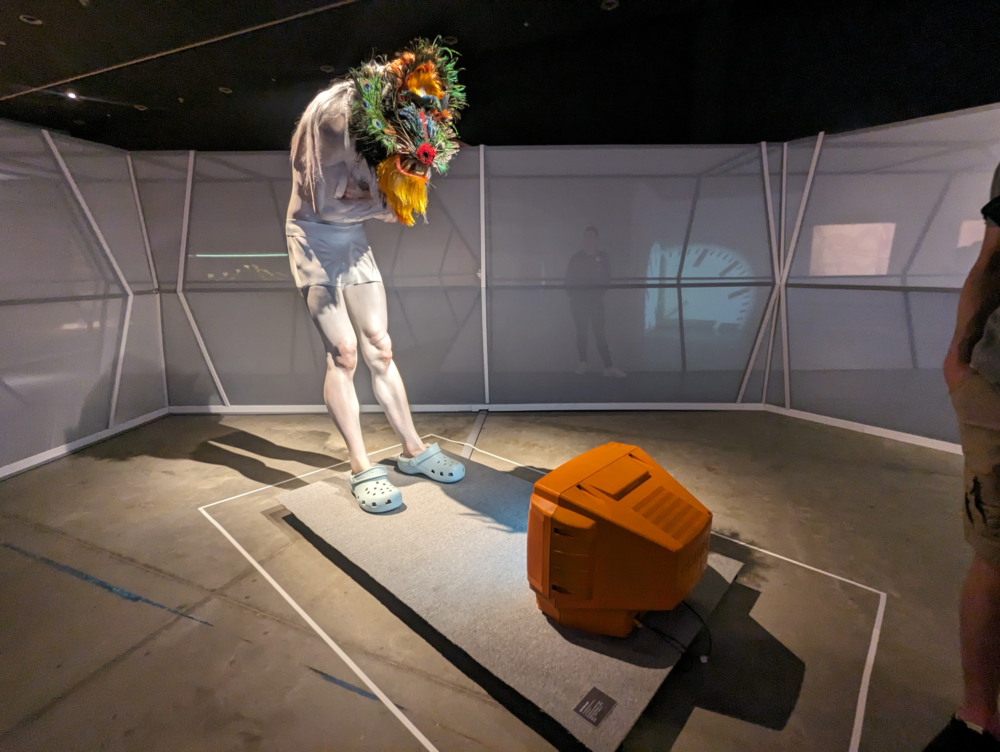

In [ ]:
# test block of CLIP model on one photo

model, preprocess = clip.load("ViT-B/32")  
image = preprocess(Image.open("./production_pictures/Buenos Aires/"+os.listdir('./production_pictures/Buenos Aires')[0])).unsqueeze(0)

# large list of possible class prompts outlining descriptive ways to capture a text label or an artwork

primary_text_labels =   [  "a museum placard with printed text",  #classes capturing text
    "a museum text label",
    "a close-up of descriptive text",
    "a label next to artwork",
    "text on a museum wall",
    "a text label for artwork that has Japanese kanji",
    

    "a painting or drawing in a museum",  # classes capturing artwork
    "a photograph with text underneath in the frame of the artwork",
    "a photograph of artwork on display",
    "a sculpture in a gallery",
    "an abstract painting",
    "a piece of modern art",
    "a Van Gogh painting",
    "a colorful woven tapestry with some embroidered text",
    "some type of art object with printed or written text",
    "artwork with some type of subtitle text"]
text_tokens = clip.tokenize(primary_text_labels)

# Generating the similarity index
with torch.no_grad():
    image_features = model.encode_image(image)
    text_features = model.encode_text(text_tokens)

    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (image_features @ text_features.T).squeeze(0)

# determining and printing the best match
predicted = primary_text_labels[similarity.argmax()]
print("Prediction:", predicted)
Image.open("./production_pictures/Buenos Aires/"+os.listdir('./production_pictures/Buenos Aires')[0])


A full run on the whole corpus

In [ ]:
# the graver error is to falsely identify an art as text and then apply downsampling, so this serves as the first step to generate a list of POSSIBLE text images

# empty list to append suggestions to
checkpics = []

# each folder is a location (city or whole country)
for folder in os.listdir('./production_pictures'):
    print(folder)
    # every folder a corpus of pictures
    for file in os.listdir('./production_pictures/'+folder):
        image = preprocess(Image.open("./production_pictures/"+folder+'/'+file)).unsqueeze(0)

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text_tokens)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)
            similarity = (image_features @ text_features.T).squeeze(0)


        predicted = primary_text_labels[similarity.argmax()]
        # if the prediction is a text label class
        if predicted in ["a museum placard with printed text", "a museum text label", "a close-up of descriptive text", "a label next to artwork", "text on a museum wall", "a text label for artwork that has Japanese kanji"]:
            #print as logging
            print("Prediction:", predicted, "Folder:", folder, "File: ", file)
            #append to the suggestions
            checkpics.append("/"+folder+"/"+file)


Amsterdam


Prediction: a museum text label Folder: Amsterdam File:  PXL_20241003_094635217.jpg
Prediction: text on a museum wall Folder: Amsterdam File:  PXL_20241003_101116010.jpg
Prediction: a museum text label Folder: Amsterdam File:  PXL_20241003_102046390.jpg
Prediction: a museum placard with printed text Folder: Amsterdam File:  PXL_20241003_102317209.jpg
Prediction: a museum placard with printed text Folder: Amsterdam File:  PXL_20241003_103952716.jpg
Prediction: a museum placard with printed text Folder: Amsterdam File:  PXL_20241003_104530734.jpg
Prediction: a museum placard with printed text Folder: Amsterdam File:  PXL_20241008_092007456.jpg
Prediction: a museum text label Folder: Amsterdam File:  PXL_20241008_092216535.jpg
Prediction: a museum text label Folder: Amsterdam File:  PXL_20241008_092626380.jpg
Prediction: a museum text label Folder: Amsterdam File:  PXL_20241008_093218326.jpg
Prediction: a museum placard with printed text Folder: Amsterdam File:  PXL_20241008_094835560.jpg

Here we run again, only on the suggested set of pictures using only two labels (indicative of art or text).

In [ ]:
# Define second-pass labels
secondary_text_labels = [
    "a picture of a printed text label",  # expected true positive
    "a picture of a painting, drawing, photograph, sculpture, or piece of art otherwise"  # likely false positive
]

text_tokens = clip.tokenize(secondary_text_labels)

# this time we'll calculate the similarity index to both labels
results = []

for pic_path in checkpics:
    try:
        image = preprocess(Image.open('./production_pictures/'+pic_path)).unsqueeze(0)

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text_tokens)

            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)

            similarity = (image_features @ text_features.T).squeeze(0).cpu().tolist()

        # every element in our list is a dictionary
        results.append({
            "filename": pic_path,
            "label_score": similarity[0],
            "art_score": similarity[1],
            "diff": similarity[0] - similarity[1]  # positive means the pic is more label-like than art-like
        })

    except Exception as e:
        print(f"Error processing {pic_path}: {e}")

#sorting as the first few images should be our false positives
results.sort(key = lambda x: x['diff'])

# the filtering value chosen separately after a couple iterations
results = [x for x in results if x['diff'] > 0.01]

And now, with hopefully all false positives removed, we perform the PCA downsampling step previously determined in the `pca_downsampling_demonstration.ipynb` notebook.

In [ ]:
for filename in results:
    # the image will be resaved as grayscale as color is not useful information to me in the context of text
    img = Image.open('./production_pictures/' + filename['filename']).convert('L')
    img_width, img_height = img.size

    # there was a thought to crop the picture to the bounding box of the recognized text, thereby deleting negative space and improving size reduction
    data = pytesseract.image_to_data(img, output_type=Output.DICT)
    boxes = [
        (int(data['left'][i]), int(data['top'][i]),
         int(data['left'][i] + data['width'][i]), int(data['top'][i] + data['height'][i]))
        for i in range(len(data['text']))
        if data['text'][i].strip() != '' and int(data['conf'][i]) > 0
    ]

    if boxes:
        # Compute raw bounding box
        x0 = min(b[0] for b in boxes)
        y0 = min(b[1] for b in boxes)
        x1 = max(b[2] for b in boxes)
        y1 = max(b[3] for b in boxes)

        # Apply 10% padding
        pad_x = int(0.10 * img_width)
        pad_y = int(0.10 * img_height)
        
        x0 = max(0, x0 - pad_x)
        y0 = max(0, y0 - pad_y)
        x1 = min(img_width, x1 + pad_x)
        y1 = min(img_height, y1 + pad_y)

        # Check if padded crop is too small
        if (x1 - x0) < 1000 or (y1 - y0) < 1000:
            print(f"Bounding box too small in {filename['filename']} — using full image.")
            cropped_img = img
        else:
            cropped_img = img.crop((x0, y0, x1, y1))

    # error handling for when PyTesseract doesn't detect any text, which has happened even on images where text is clearly visible
    else:
        print(f"No text detected in {filename['filename']}, using full image.")
        cropped_img = img  

    # PCA downsampling step
    img_array = np.array(cropped_img).astype(np.float32)
    n_components = min(50, img_array.shape[0], img_array.shape[1])

    pca = PCA(n_components=n_components)
    transformed = pca.fit_transform(img_array)
    reconstructed = pca.inverse_transform(transformed)
    reconstructed_img = np.clip(reconstructed, 0, 255).astype(np.uint8)

    # Saves to a new folder for later comparison
    folder_name = filename['filename'].split('/')[1] + "_downsampled"
    os.makedirs(f"./production_pictures/{folder_name}", exist_ok=True)
    out_path = f"./production_pictures/{folder_name}/" + filename['filename'].split('/')[2]
    Image.fromarray(reconstructed_img, mode='L').save(out_path, format='JPEG', quality=85)


Bounding box too small in \Buenos Aires\PXL_20250308_220848457.jpg — using full image.
Bounding box too small in \Barcelona\PXL_20241103_114353982.jpg — using full image.
No text detected in \Paris\PXL_20241130_144129717.jpg, using full image.
No text detected in \Amsterdam\PXL_20241008_121754526.jpg, using full image.
No text detected in \Barcelona\PXL_20241105_124322053.jpg, using full image.
No text detected in \Madrid\PXL_20241114_160658961.jpg, using full image.
No text detected in \Paris\PXL_20241130_150752995.jpg, using full image.
No text detected in \Paris\PXL_20241130_150307187.jpg, using full image.
No text detected in \Buenos Aires\PXL_20250319_202609947.jpg, using full image.
Bounding box too small in \Madrid\PXL_20241114_155223616.jpg — using full image.
No text detected in \Madrid\PXL_20241114_161735609.jpg, using full image.
No text detected in \Hakone\PXL_20250227_030939245.jpg, using full image.
No text detected in \Madrid\PXL_20241114_172637424.jpg, using full image.

Observing the size savings

In [ ]:
import os

def get_folder_size(path):
    total_size = 0
    for dirpath, dirnames, filenames in os.walk(path):
        for filename in filenames:
            filepath = os.path.join(dirpath, filename)
            # skip if it's a broken symlink
            if os.path.isfile(filepath):
                total_size += os.path.getsize(filepath)
    return total_size

old_size = []
new_size = []

for place in set([x.split('/')[1] for x in checkpics if not(x.split('/')[1].endswith('_downsampled'))]):
    folder_path = "./production_pictures/"+place
    size_bytes = get_folder_size(folder_path)
    size_mb = size_bytes / (1024 * 1024)
    old_size.append(size_mb)


#this is only run after manually copying the unchanged art pics to the relevant downsampled folders
for place in [x for x in os.listdir('./production_pictures') if x.endswith('downsampled')]:
    folder_path = "./production_pictures/"+place
    size_bytes = get_folder_size(folder_path)
    size_mb = size_bytes / (1024 * 1024)
    new_size.append(size_mb)
                    
old_size = sum(old_size)

new_size = sum(new_size)

print('Previously, the total size between art and text pics was' , round(old_size, 2), 'mb. \
      \nAfter the CLIP and OCR assisted downsampling, the total size is' , round(new_size, 2) , 'mb. \
      \nThis is a total savings of' , round(old_size - new_size, 2), 'mb.')

Previously, the total size between art and text pics was 1640.62 mb.       
After the CLIP and OCR assisted downsampling, the total size is 1242.48 mb.       
This is a total savings of 398.14 mb.
